In [1]:
import pandas as pd
import os
import sys
import matplotlib.pyplot as plt
from pathlib import Path
from PIL import Image
import numpy as np

sys.path.append(os.path.abspath("Ladder/src/codebase"))

from prompts.gpt4_prompt import create_NIH_prompts, create_RSNA_prompts, create_CELEBA_prompts, \
    create_Waterbirds_prompts, create_Metashift_prompts

%matplotlib inline

In [2]:
classifier_check_pt="Ladder/out/Waterbirds/resnet_sup_in1k_attrNo/Waterbirds_ERM_hparams0_seed0/model.pkl" 
save_path="Ladder/out/Waterbirds/resnet_sup_in1k_attrNo/Waterbirds_ERM_hparams0_seed0/clip_img_encoder_ViT-B/32" 
clf_waterbirds_results_csv="Ladder/out/Waterbirds/resnet_sup_in1k_attrNo/Waterbirds_ERM_hparams0_seed0/clip_img_encoder_ViT-B/32/valid_waterbirds_dataframe_mitigation.csv" 
clf_landbirds_results_csv="Ladder/out/Waterbirds/resnet_sup_in1k_attrNo/Waterbirds_ERM_hparams0_seed0/clip_img_encoder_ViT-B/32/valid_landbirds_dataframe_mitigation.csv" 
top50_err_text="Ladder/out/Waterbirds/resnet_sup_in1k_attrNo/Waterbirds_ERM_hparams0_seed0/clip_img_encoder_ViT-B/32/waterbirds_error_top_200_sent_diff_emb.txt"
img_path = Path("Ladder/data/waterbirds/waterbird_complete95_forest2water2")


discover_log_txt = "Ladder/out/Waterbirds/resnet_sup_in1k_attrNo/Waterbirds_ERM_hparams0_seed0/clip_img_encoder_ViT-B/32/ladder_discover_slices_performance_ERM.txt"
validation_landbird_log_txt = "Ladder/out/Waterbirds/resnet_sup_in1k_attrNo/Waterbirds_ERM_hparams0_seed0/clip_img_encoder_ViT-B/32/ladder_validate_slices_w_LLM-landbirds.txt"
validation_waterbird_log_txt = "Ladder/out/Waterbirds/resnet_sup_in1k_attrNo/Waterbirds_ERM_hparams0_seed0/clip_img_encoder_ViT-B/32/ladder_validate_slices_w_LLM-waterbirds.txt"

mitigate_log_txt = "Ladder/out/Waterbirds/resnet_sup_in1k_attrNo/Waterbirds_ERM_hparams0_seed0/clip_img_encoder_ViT-B/32/ladder_mitigate_slices.txt"

### Original model (ERM) performance

In [3]:
print("Original ERM model performance: ")
with open(discover_log_txt, 'r') as file:
    content = file.read()
    print(content)

Original ERM model performance: 
Mean acc: 0.8802209181912323
Worst group acc: 0.6884735202492211



### After mitigation model performance (Sec. 3.3 in the paper)

In [4]:
print("After mitigation model performance: ")
with open(mitigate_log_txt, 'r') as file:
    content = file.read()
    print(content)

After mitigation model performance: 
Mean acc: 0.9233690024162927
Worst group acc: 0.8957871396895787



### Validation phase for discovering biases (Sec. 3.2 in the paper)

In [5]:
print(f"Biases for landbird class:")
with open(validation_landbird_log_txt, 'r') as file:
    content = file.read()
    print(content)

Biases for landbird class:
Hypothesis Dictionary:
{'H1': 'The classifier is making mistake as it is biased toward yellow', 'H2': 'The classifier is making mistake as it is biased toward bamboo', 'H3': 'The classifier is making mistake as it is biased toward forest', 'H4': 'The classifier is making mistake as it is biased toward perched', 'H5': 'The classifier is making mistake as it is biased toward green', 'H6': 'The classifier is making mistake as it is biased toward small', 'H7': 'The classifier is making mistake as it is biased toward vibrant', 'H8': 'The classifier is making mistake as it is biased toward black', 'H9': 'The classifier is making mistake as it is biased toward red', 'H10': 'The classifier is making mistake as it is biased toward brown'}

Prompt Dictionary:
{'H1_yellow': ['A bird with yellow feathers', 'A vibrant yellow bird', 'A bird with a yellow belly', 'A bird with a yellow head', 'A bird with yellow and black plumage'], 'H2_bamboo': ['A bird among bamboo stalks'

In [6]:
print(f"Biases for waterbird class:")
with open(validation_waterbird_log_txt, 'r') as file:
    content = file.read()
    print(content)

Biases for waterbird class:
Hypothesis Dictionary:
{'H1': 'The classifier is making mistake as it is biased toward large', 'H2': 'The classifier is making mistake as it is biased toward seagull', 'H3': 'The classifier is making mistake as it is biased toward water', 'H4': 'The classifier is making mistake as it is biased toward beach', 'H5': 'The classifier is making mistake as it is biased toward sky', 'H6': 'The classifier is making mistake as it is biased toward sunset', 'H7': 'The classifier is making mistake as it is biased toward boats', 'H8': 'The classifier is making mistake as it is biased toward digitally altered', 'H9': 'The classifier is making mistake as it is biased toward harbor', 'H10': 'The classifier is making mistake as it is biased toward rocks'}

Prompt Dictionary:
{'H1_large': ['A large bird is flying over the ocean', 'A large bird is standing on a beach', 'A large bird is perched on a rock', 'A large bird is swimming in the water', 'A large bird is walking along 

### Prompt details

In [7]:
with open(top50_err_text, "r") as file:
    content = file.read()

prompt = create_Waterbirds_prompts(content)
print(prompt)


    Context: Bird classification from images using a deep neural network
    Analysis post training: On a validation set, 
    a. Get the difference between the image embeddings of correct and incorrectly classified samples.
    b. Retrieve the top K sentences from the captions of the images that matches closely to the embedding difference in step a.
    c. The sentence list is given below in the descending order of similarity with the embedding difference:
    1. A large seagull stands on a dock against a backdrop of a harbor with boats and a blue sky
2. A digitally altered image features a large bird, possibly an albatross, superimposed over a backdrop of industrial buildings by a body of water
3. A seagull stands on rocks by the water at sunset, with a lighthouse visible in the background
4. A large seagull is superimposed on a beach scene with kayaks in the background by the sea
5. A large white bird, possibly a pelican, stands in a body of water with an old brick building in the 

### Qualitative examples (Waterbirds)

In [8]:
n_samples = 100
meta = pd.read_csv("Ladder/data/waterbirds/va_metadata_waterbirds_captioning_blip.csv")
ddf = pd.read_csv(clf_waterbirds_results_csv)
ddf["filename"] = meta["filename"].values
ddf["blip_caption"] = meta["blip_caption"].values
ddf["pred_bin"] = (ddf["out_put_predict"]>=0.5).astype(int)


In [9]:
def display_sorted_images(
    ddf,
    meta,
    img_path,
    sort_column,
    n_samples=12,
    gt_filter=1,
    title_prefix="Samples",
    columns=3,
    image_size=(224, 224),
    caption_fontsize=10
):
    df = ddf.copy()
    df["filename"] = meta["filename"].values
    df["pred_bin"] = (df["out_put_predict"] >= 0.5).astype(int)

    filtered_df = df[df["out_put_GT"] == gt_filter]
    sorted_df = filtered_df.sort_values(by=sort_column, ascending=False).reset_index(drop=True)

    top_df = sorted_df.head(n_samples)
    bottom_df = sorted_df.tail(n_samples)

    def plot(df_part, title):
        rows = (len(df_part) + columns - 1) // columns
        fig, axs = plt.subplots(rows, columns, figsize=(5 * columns, 5 * rows))
        axs = axs.flatten()

        for ax, (_, row) in zip(axs, df_part.iterrows()):
            image_path = img_path / row["filename"]
            image = Image.open(image_path).convert("RGB").resize(image_size)
            ax.imshow(image)
            ax.axis('off')
        
        for ax in axs[len(df_part):]:
            ax.axis('off')

        fig.suptitle(title, fontsize=16, weight='bold')
        plt.tight_layout()
        plt.subplots_adjust(top=0.93)
        plt.show()

    plot(top_df, f"Class: {title_prefix}, Top {n_samples} images aligned with the bias {sort_column}")



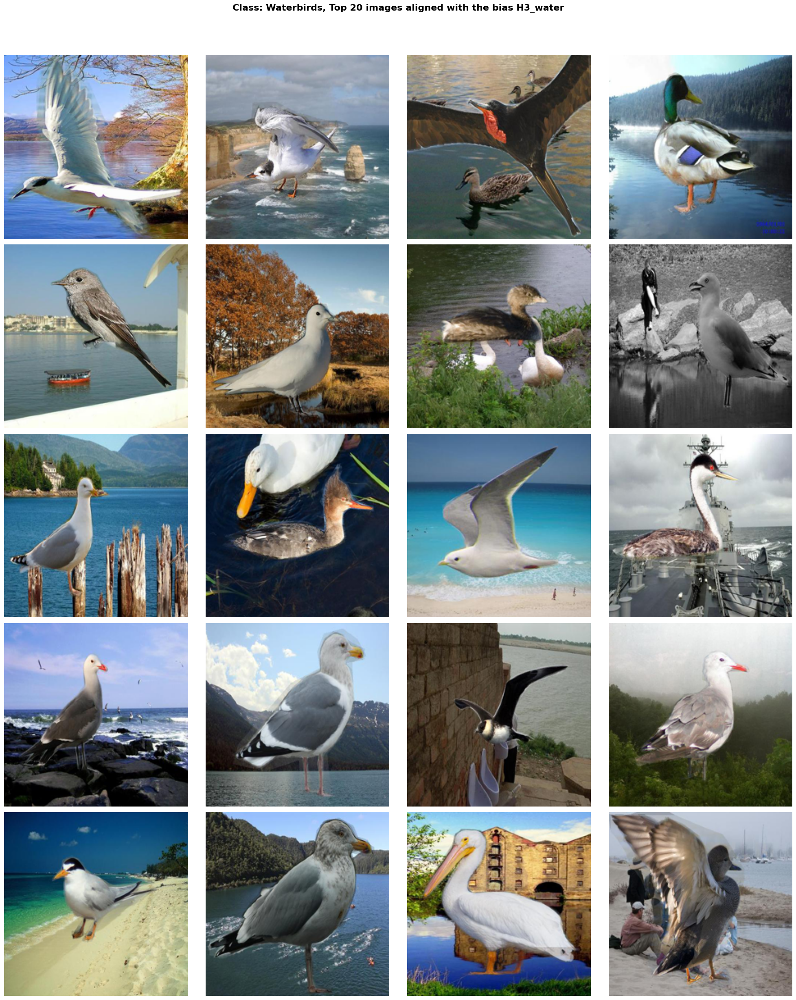

In [10]:
display_sorted_images(
    ddf=ddf,
    meta=meta,
    img_path=img_path,
    sort_column="H3_water",
    n_samples=20,
    gt_filter=1,
    title_prefix="Waterbirds",
    columns=4,
    caption_fontsize=12
)

### Qualitative examples (Landbirds)

In [11]:
n_samples = 100
meta = pd.read_csv("Ladder/data/waterbirds/va_metadata_waterbirds_captioning_blip.csv")
ddf = pd.read_csv(clf_landbirds_results_csv)
ddf["filename"] = meta["filename"].values
ddf["blip_caption"] = meta["blip_caption"].values
ddf["pred_bin"] = (ddf["out_put_predict"]>=0.5).astype(int)
print(ddf.columns)

Index(['out_put_GT', 'out_put_predict', 'attribute_bg_predict', 'idx', 'gs',
       'Predictions_bin', 'H1_yellow', 'H1_yellow_bin', 'H2_bamboo',
       'H2_bamboo_bin', 'H3_forest', 'H3_forest_bin', 'H4_perched',
       'H4_perched_bin', 'H5_green', 'H5_green_bin', 'H6_small',
       'H6_small_bin', 'H7_vibrant', 'H7_vibrant_bin', 'H8_black',
       'H8_black_bin', 'H9_red', 'H9_red_bin', 'H10_brown', 'H10_brown_bin',
       'filename', 'blip_caption', 'pred_bin'],
      dtype='object')


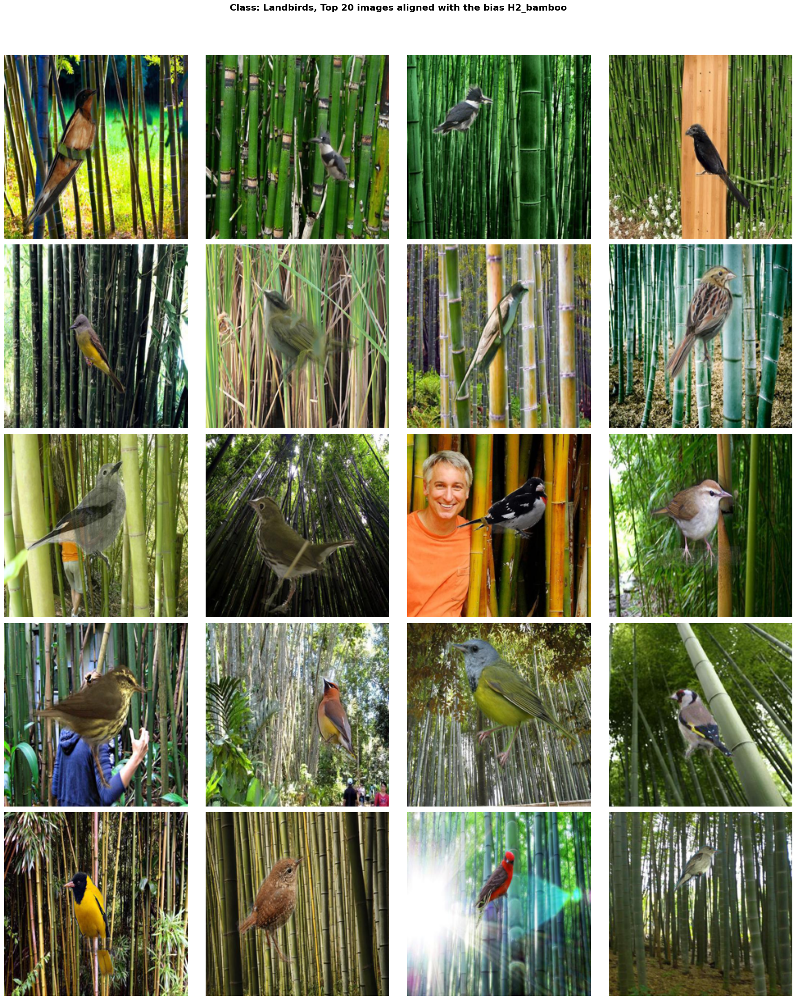

In [14]:
display_sorted_images(
    ddf=ddf,
    meta=meta,
    img_path=img_path,
    sort_column="H2_bamboo",
    n_samples=20,
    gt_filter=0,
    title_prefix="Landbirds",
    columns=4,
    caption_fontsize=12
)

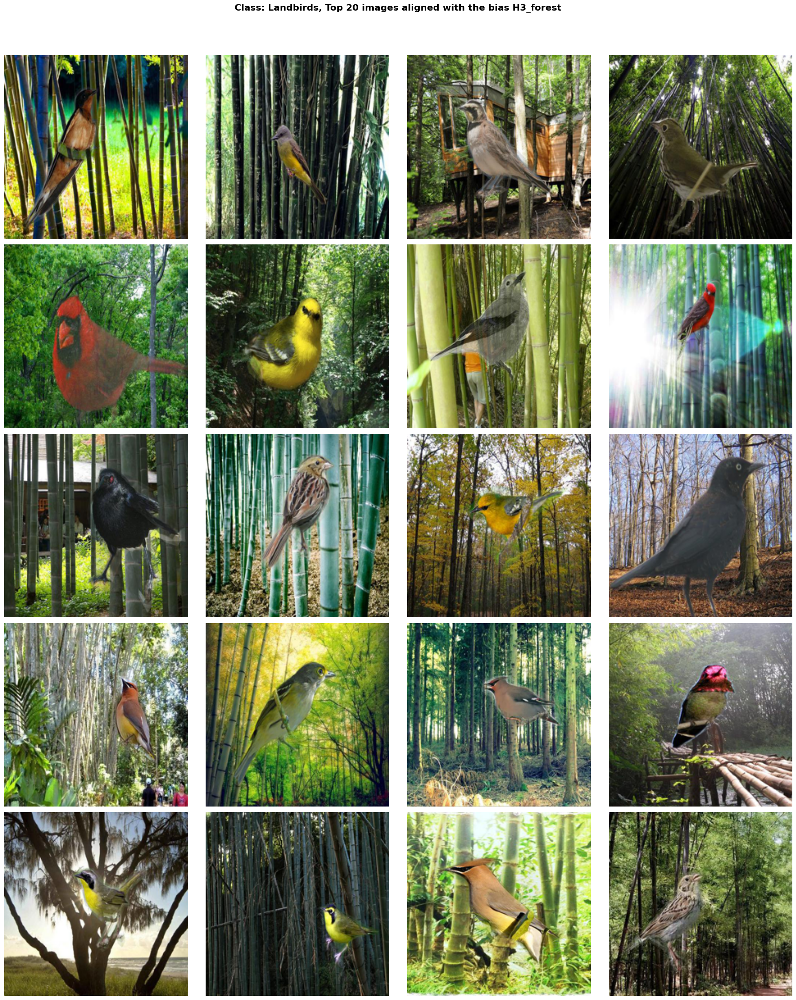

In [15]:
display_sorted_images(
    ddf=ddf,
    meta=meta,
    img_path=img_path,
    sort_column="H3_forest",
    n_samples=20,
    gt_filter=0,
    title_prefix="Landbirds",
    columns=4,
    caption_fontsize=12
)